In [1]:
import uproot
import numpy as np
import pandas as pd
import h5py
import seaborn as sns
import matplotlib.pylab as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_classification

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import SGD, Adam, RMSprop, Adagrad, Adadelta
from tensorflow.keras.layers import Input, Activation, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras import utils
from tensorflow import random as tf_random
from tensorflow.keras.utils import plot_model
import random as python_random
import glob
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_roc_curve
from sklearn.model_selection import GridSearchCV
import matplotlib as mpl
import matplotlib.pyplot as plt
#Let's import all the metrics that we need later on!
from sklearn.metrics import ConfusionMatrixDisplay,confusion_matrix,accuracy_score 
from sklearn.metrics import precision_score , recall_score , precision_recall_curve 
from sklearn.metrics import roc_curve, auc , roc_auc_score 
import pickle

In [2]:
inputDatadirectory = '/scratch_hdd/TrackTrajectory/4mu/'
# this input directory does not work, I mean it does not pick the path, I dont understand the problem of swan
seed = 7
np.random.seed(seed)
python_random.seed(seed)
tf_random.set_seed(seed)

treename = 'HZZ4LeptonsAnalysisReduced'
filename = {}
upfile = {}
params = {}
df = {} 



# signal and background

filename['sig'] = '/scratch_hdd/TrackTrajectory/4mu/VBF_HToZZTo4L.root'
filename['bkg_ggHtoZZto4mu'] = '/scratch_hdd/TrackTrajectory/4mu/GluGluHToZZTo4L.root'
filename['bkg_ZZto4mu'] = '/scratch_hdd/TrackTrajectory/4mu/ZZTo4L.root'
filename['bkg_WH_HToZZTo4mu']= '/scratch_hdd/TrackTrajectory/4mu/WH_HToZZTo4L.root'
filename['bkg_ttH_HToZZ_4mu']= '/scratch_hdd/TrackTrajectory/4mu/ttH_HToZZ_4L.root'

# Variables from Root Tree that must be copyed to PANDA dataframe (df)
VARS = [ 'f_run', 'f_event', 'f_weight', \
        'f_massjj', 'f_deltajj', 'f_mass4l', 'f_Z1mass' , 'f_Z2mass', \
        'f_lept1_pt','f_lept1_eta','f_lept1_phi', \
        'f_lept2_pt','f_lept2_eta','f_lept2_phi', \
        'f_lept3_pt','f_lept3_eta','f_lept3_phi', \
        'f_lept4_pt','f_lept4_eta','f_lept4_phi', \
        'f_jet1_pt','f_jet1_eta','f_jet1_phi', \
        'f_jet2_pt','f_jet2_eta','f_jet2_phi' ]

#checking the dimensions of the df , 26 variables
NDIM = len(VARS)

print("Number of kinematic variables imported from the ROOT files = %d"% NDIM)

upfile['sig'] = uproot.open(filename['sig'])
upfile['bkg_ggHtoZZto4mu'] = uproot.open(filename['bkg_ggHtoZZto4mu'])
upfile['bkg_ZZto4mu'] = uproot.open(filename['bkg_ZZto4mu'])
upfile['bkg_WH_HToZZTo4mu'] = uproot.open(filename['bkg_WH_HToZZTo4mu'])
upfile['bkg_ttH_HToZZ_4mu'] = uproot.open(filename['bkg_ttH_HToZZ_4mu'])

Number of kinematic variables imported from the ROOT files = 26


In [3]:
df['sig'] = pd.DataFrame(upfile['sig'][treename].arrays(VARS, library="np"),columns=VARS)
print(df['sig'].shape)
df['sig'].head()

(24867, 26)


,f_run,f_event,f_weight,f_massjj,f_deltajj,f_mass4l,f_Z1mass,f_Z2mass,f_lept1_pt,f_lept1_eta,...,f_lept3_phi,f_lept4_pt,f_lept4_eta,f_lept4_phi,f_jet1_pt,f_jet1_eta,f_jet1_phi,f_jet2_pt,f_jet2_eta,f_jet2_phi
0,1,385228,0.000176,667.271423,3.739947,124.966576,90.768616,20.508274,82.890457,0.822203,...,2.497204,28.562206,0.174666,2.013540,116.326035,-1.126533,-1.759238,90.333893,2.613415,-0.096671
1,1,385233,0.000127,129.085892,0.046317,120.231926,80.782318,34.261726,41.195362,-0.534245,...,-2.938914,16.676077,-0.162915,1.783374,105.491882,3.253374,-1.297283,38.978493,3.207056,1.553476
2,1,385254,0.000037,285.165222,3.166899,125.254646,91.392693,25.695290,80.788002,0.943778,...,-2.670540,14.581854,1.516623,0.284658,69.315170,2.573589,-2.030811,51.972664,-0.593310,-2.799394
3,1,385260,0.000043,52.006794,0.150803,125.067009,91.183708,19.631315,129.883423,0.235406,...,-1.533120,8.197763,-0.157577,0.339215,202.689468,2.530802,1.325786,41.343758,2.681605,0.858582
4,1,385263,0.000092,1044.083496,4.315164,124.305748,72.480515,43.826504,86.220734,-0.226653,...,-0.072236,21.243813,-0.579560,-0.884727,127.192223,-2.362456,-2.945257,115.200272,1.952708,2.053301


In [4]:
def formatted_head(df):
  from io import StringIO
  buffer = StringIO()
  df.head(2).to_string(buffer, na_rep='', float_format='%.2f')
  return buffer.getvalue()
df['bkg_ggHtoZZto4mu'] = pd.DataFrame(upfile['bkg_ggHtoZZto4mu'][treename].arrays(VARS, library="np"),columns=VARS)
df['bkg_ZZto4mu'] = pd.DataFrame(upfile['bkg_ZZto4mu'][treename].arrays(VARS, library="np"),columns=VARS)
df['bkg_ttH_HToZZ_4mu'] = pd.DataFrame(upfile['bkg_ttH_HToZZ_4mu'][treename].arrays(VARS, library="np"),columns=VARS)
df['bkg_WH_HToZZTo4mu'] = pd.DataFrame(upfile['bkg_WH_HToZZTo4mu'][treename].arrays(VARS, library="np"),columns=VARS)
print(formatted_head(df['bkg_ggHtoZZto4mu']))
print(formatted_head(df['bkg_ZZto4mu']))
print(formatted_head(df['bkg_ttH_HToZZ_4mu']))
print(formatted_head(df['bkg_WH_HToZZTo4mu']))

   f_run  f_event  f_weight  f_massjj  f_deltajj  f_mass4l  f_Z1mass  f_Z2mass  f_lept1_pt  f_lept1_eta  f_lept1_phi  f_lept2_pt  f_lept2_eta  f_lept2_phi  f_lept3_pt  f_lept3_eta  f_lept3_phi  f_lept4_pt  f_lept4_eta  f_lept4_phi  f_jet1_pt  f_jet1_eta  f_jet1_phi  f_jet2_pt  f_jet2_eta  f_jet2_phi
0      1   581632      0.00   -999.00    -999.00    120.10     88.26     22.05       57.57        -0.43        -0.89       56.93         0.50         0.40       33.58        -0.04         0.29       10.88        -1.11         0.05      73.54        1.68        2.74    -999.00     -999.00     -999.00
1      1   581659      0.00   -999.00    -999.00    124.59     82.17     17.61       50.37         0.00         0.93       31.55         0.60        -1.86       22.76         0.22        -2.77       17.26         0.36        -1.86    -999.00     -999.00     -999.00    -999.00     -999.00     -999.00
   f_run  f_event  f_weight  f_massjj  f_deltajj  f_mass4l  f_Z1mass  f_Z2mass  f_lept1_pt  f_lep

In [5]:
df['bkg_ZZto4mu'] = pd.DataFrame(upfile['bkg_ZZto4mu'][treename].arrays(VARS, library="np"),columns=VARS)
df['bkg_ZZto4mu'].head()

,f_run,f_event,f_weight,f_massjj,f_deltajj,f_mass4l,f_Z1mass,f_Z2mass,f_lept1_pt,f_lept1_eta,...,f_lept3_phi,f_lept4_pt,f_lept4_eta,f_lept4_phi,f_jet1_pt,f_jet1_eta,f_jet1_phi,f_jet2_pt,f_jet2_eta,f_jet2_phi
0,1,1991117,0.001420,384.394165,0.235409,309.921478,93.538399,87.436043,84.918190,-0.073681,...,-1.046433,42.139397,0.966109,2.593184,240.828506,0.103300,2.408482,195.838226,0.338708,0.285348
1,1,1991192,0.000893,110.589844,0.956070,326.481903,92.948936,85.379288,124.270218,1.388811,...,1.626933,18.505959,2.012172,2.229677,77.210411,2.061765,-0.532572,48.432365,1.105695,1.128457
2,1,1991331,0.000839,-999.000000,-999.000000,91.167046,56.161217,14.535084,25.241573,1.410529,...,2.017863,9.831321,-1.329539,2.286600,66.642792,1.176917,-1.089489,-999.000000,-999.000000,-999.000000
3,1,1991364,0.000906,-999.000000,-999.000000,323.428345,88.717270,94.940346,65.728729,-0.561113,...,-1.756674,33.169487,0.367907,-0.241346,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000
4,1,1991360,0.001034,-999.000000,-999.000000,274.207916,90.799271,90.156898,101.931305,0.828778,...,0.046896,20.806948,0.173602,-1.466702,56.815113,2.660174,1.771598,-999.000000,-999.000000,-999.000000


In [6]:
#Adding the bkg processes 
df['bkg'] = pd.concat([df['bkg_ZZto4mu'],df['bkg_ggHtoZZto4mu'],df['bkg_ttH_HToZZ_4mu'],df['bkg_WH_HToZZTo4mu']])
df['bkg']= shuffle(df['bkg'])
print(df['bkg'].shape)
print(len(df['bkg']))

(987027, 26)
987027


In [7]:
# Remove undefined variable entries VARS[i] <= -999
for i in range(NDIM):
    df['sig']= df['sig'][(df['sig'][VARS[i]] > -999)]
    df['bkg']= df['bkg'][(df['bkg'][VARS[i]] > -999)]
# Add the columnisSignal to the dataframe containing the truth information
# i.e. it tells if that particular event is signal (isSignal=1) or background (isSignal=0)
df['sig']['isSignal'] = np.ones(len(df['sig'])) 
df['bkg']['isSignal'] = np.zeros(len(df['bkg'])) 
print("Number of Signal events = %d " %len(df['sig']['isSignal']))
print("Number of Background events = %d " %len(df['bkg']['isSignal']))

Number of Signal events = 14260 
Number of Background events = 122837 


In [8]:
#Showing that the variable isSignal is correctly assigned for VBF signal events
print(df['sig']['isSignal'])
print(df['bkg']['isSignal'])

0        1.0
1        1.0
2        1.0
3        1.0
4        1.0
        ... 
24858    1.0
24859    1.0
24860    1.0
24861    1.0
24862    1.0
Name: isSignal, Length: 14260, dtype: float64
486030    0.0
257752    0.0
5725      0.0
24561     0.0
219648    0.0
         ... 
551642    0.0
315737    0.0
759363    0.0
535030    0.0
189636    0.0
Name: isSignal, Length: 122837, dtype: float64


In [9]:
# Renormalizes the events weights to give unit sum in the signal and background dataframes
# This is necessary for the ML algorithms to learn signal and background 
# in the same proportion,independently of number of events 
# and absolute weights of events in each sample of events!
# The relative contributions of each background process is retained - so the classifier
# learns to focus more on the importance backgrounds, and the background matches the data
# shape - but overall signal and background have equal importance (the classifier
# learns to identify signal and background equally well).
# In the pandas technical vocabolary axis=0 stands for columns, axis=1 for rows.
df['sig']['f_weight']=df['sig']['f_weight']/df['sig']['f_weight'].sum(axis=0)
df['bkg']['f_weight']=df['bkg']['f_weight']/df['bkg']['f_weight'].sum(axis=0)
# Note: Number of events remain unchanged after this "normalization procedure"
print("Number SIG events=", len(df['sig']['f_weight']))
print("Number BKG events=", len(df['bkg']['f_weight']))

Number SIG events= 14260
Number BKG events= 122837


In [10]:
# Concatenate the signal and background dfs in a single data frame 
df_all = pd.concat([df['sig'],df['bkg']])
# Random shuffles the dataset to mix signal and background events 
# before the splitting between train and test datasets
df_all = shuffle(df_all)
VAR = ['f_massjj', 'f_deltajj', 'f_mass4l', 'f_Z1mass' , 'f_Z2mass', 'isSignal']
df_all_reset_index = df_all.reset_index(drop=True)

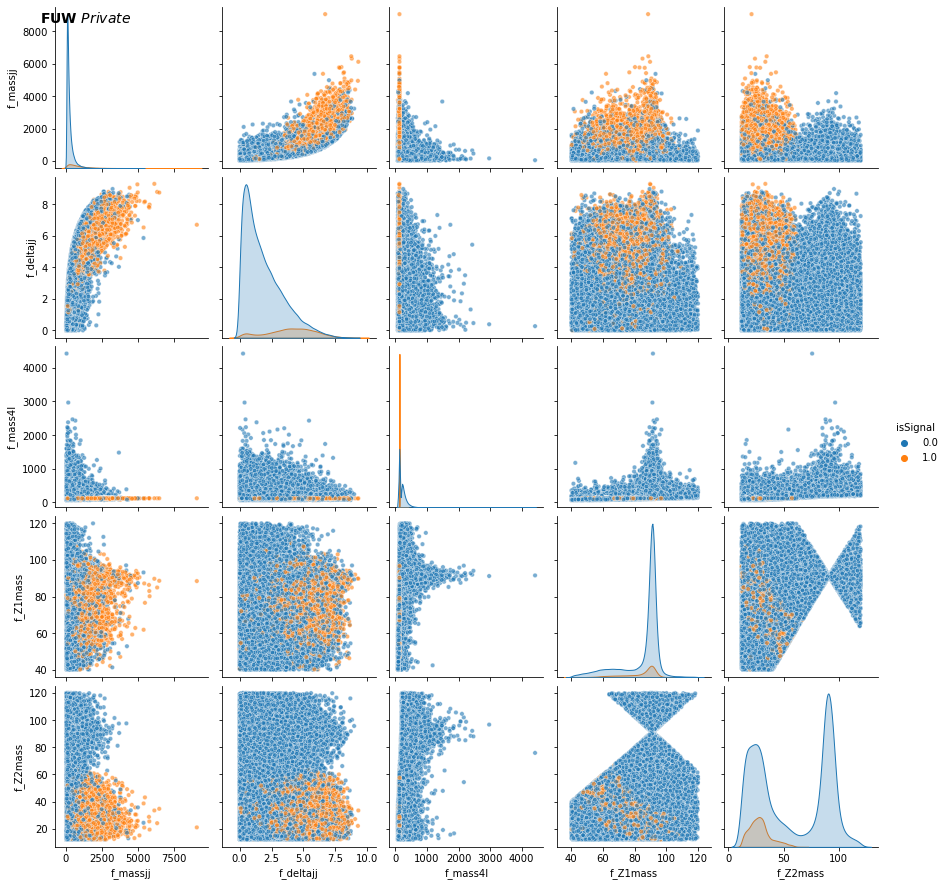

In [11]:
#It will take a while (5 minutes), you can skip it as said before.
# We leave you the output of this code cell using a .png format
VAR = ['f_massjj', 'f_deltajj', 'f_mass4l', 'f_Z1mass' , 'f_Z2mass', 'isSignal']
df_all_reset_index = df_all.reset_index(drop=True)
pairplot = sns.pairplot(data=df_all_reset_index.filter(VAR), hue='isSignal' , kind='scatter', diag_kind='auto', 
            plot_kws={'s': 20, 'edgecolor': 'w', 'linewidth': 0.5, 'alpha': 0.6})
pairplot.fig.suptitle(r'$\mathbf{FUW}$ $\mathit{Private}$', fontsize=14, ha='left', x=0.05,)
plt.savefig('pairplotofsignal.pdf')
plt.show()

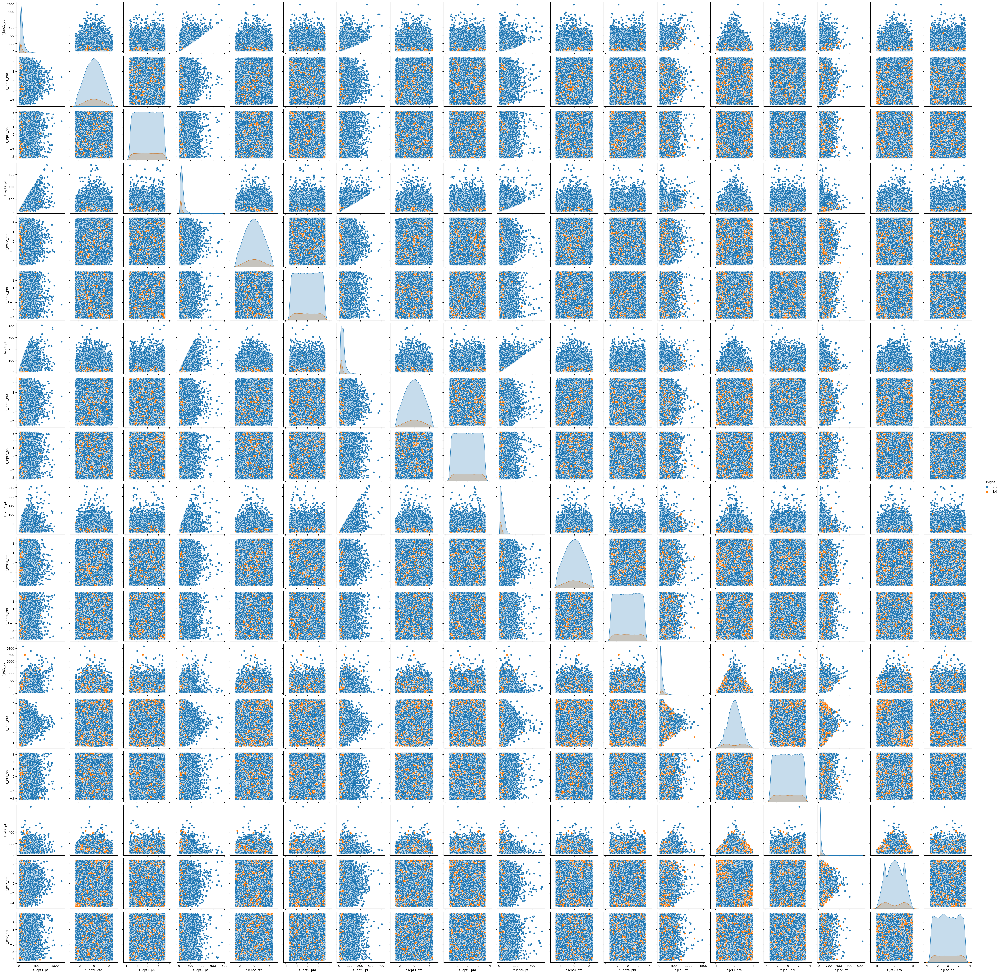

In [32]:
NN_VARS = ['f_lept1_pt','f_lept1_eta','f_lept1_phi', \
          'f_lept2_pt','f_lept2_eta','f_lept2_phi', \
          'f_lept3_pt','f_lept3_eta','f_lept3_phi', \
           'f_lept4_pt','f_lept4_eta','f_lept4_phi', \
           'f_jet1_pt','f_jet1_eta','f_jet1_phi', \
           'f_jet2_pt','f_jet2_eta','f_jet2_phi', 'isSignal']
df_all_reset_index = df_all.reset_index(drop=True)
sns.pairplot(data=df_all_reset_index.filter(NN_VARS), hue='isSignal' , kind='scatter', diag_kind='auto' )

In [11]:
# Filter dataframe leaving just the Neural Network and Random Forest input variables  
import os 
outdir= "/scratch_hdd/TrackTrajectory/ForNotLevelOne/Exercise06/"
filename = "hzzfourlepton_ANN.h5"
model_path = os.path.join(outdir, filename)
os.makedirs(outdir, exist_ok=True)


NN_VARS= ['f_massjj', 'f_deltajj', 'f_mass4l', 'f_Z1mass' , 'f_Z2mass']
# NN_VARS = [ 'f_lept1_pt','f_lept1_eta','f_lept1_phi', \
#          'f_lept2_pt','f_lept2_eta','f_lept2_phi', \
#          'f_lept3_pt','f_lept3_eta','f_lept3_phi', \
#          'f_lept4_pt','f_lept4_eta','f_lept4_phi', \
#          'f_jet1_pt','f_jet1_eta','f_jet1_phi', \
#          'f_jet2_pt','f_jet2_eta','f_jet2_phi']
         
df_input  = df_all.filter(NN_VARS)
df_target = df_all.filter(['isSignal']) # flag
df_weights = df_all.filter(['f_weight']) 
# the weights are also important to be given as input to the training

# Transform dataframes to numpy arrays of float32 
# (X->NN input , Y->NN target output , W-> event weights)

NINPUT=len(NN_VARS)
print("Number NN input variables=",NINPUT)
print("NN input variables=",NN_VARS)
X  = np.asarray( df_input.values ).astype(np.float32)
Y  = np.asarray( df_target.values ).astype(np.float32)
W  = np.asarray( df_weights.values ).astype(np.float32)
print(X.shape)
print(Y.shape)
print(W.shape)
print('\n')

Number NN input variables= 5
NN input variables= ['f_massjj', 'f_deltajj', 'f_mass4l', 'f_Z1mass', 'f_Z2mass']
(137097, 5)
(137097, 1)
(137097, 1)




In [12]:
# Classical way to proceed, using a scikit-learn algorithm:
# X_train_val, X_test, Y_train_val , Y_test , W_train_val , W_test = 
# train_test_split(X, Y, W , test_size=0.2,shuffle=None,stratify=None )

# Alternative way, the one that we chose in order to study the model's performance 
# with ease (with an analogous procedure used by TMVA in ROOT framework)
# to keep information about the flag isSignal in both training and test steps. 

size= int(len(X[:,0]))
test_size = int(0.2*len(X[:,0]))
print('X (features) before splitting')
print('\n')
print(X.shape)
print('X (features) splitting between test and training')
X_test= X[0:test_size+1,:]
print('Test:')
print(X_test.shape)
X_train_val= X[test_size+1:len(X[:,0]),:]
print('Training:')
print(X_train_val.shape)
print('\n')
print('Y (target) before splitting')
print('\n')
print(Y.shape)
print('Y (target) splitting between test and training ')
Y_test= Y[0:test_size+1,:]
print('Test:')
print(Y_test.shape)
Y_train_val= Y[test_size+1:len(Y[:,0]),:]
print('Training:')
print(Y_train_val.shape)
print('\n')
print('W (weights) before splitting')
print('\n')
print(W.shape)
print('W (weights) splitting between test and training ')
W_test= W[0:test_size+1,:]
print('Test:')
print(W_test.shape)
W_train_val= W[test_size+1:len(W[:,0]),:]
print('Training:')
print(W_train_val.shape)
print('\n')

X (features) before splitting


(137097, 5)
X (features) splitting between test and training
Test:
(27420, 5)
Training:
(109677, 5)


Y (target) before splitting


(137097, 1)
Y (target) splitting between test and training 
Test:
(27420, 1)
Training:
(109677, 1)


W (weights) before splitting


(137097, 1)
W (weights) splitting between test and training 
Test:
(27420, 1)
Training:
(109677, 1)




In [14]:
# Define Neural Network with 3 hidden layers ( #h1=10*NINPUT , #h2=2*NINPUT , #h3=NINPUT ) & Dropout layers

input  = Input(shape=(NINPUT,), name = 'input') 
hidden = Dense(NINPUT*10, name = 'hidden1', kernel_initializer='normal', activation='selu')(input)
hidden = Dropout(rate=0.1)(hidden)
hidden = Dense(NINPUT*2 , name = 'hidden2', kernel_initializer='normal', activation='selu')(hidden)
hidden = Dropout(rate=0.1)(hidden)
hidden = Dense(NINPUT, name = 'hidden3', kernel_initializer='normal', activation='selu')(hidden)
hidden = Dropout(rate=0.1)(hidden)
output  = Dense(1 , name = 'output', kernel_initializer='normal', activation='sigmoid')(hidden)


# create the model
model = Model(inputs=input, outputs=output)
# Define the optimizer ( minimization algorithm )
#optim = SGD(lr=0.01,decay=1e-6)
#optim = Adam( lr=0.0001 )
#optim = Adagrad(learning_rate=0.0001 )
#optim = Adadelta(learning_rate=0.0001 )
#optim = RMSprop() #default lr= 1e-3
optim = RMSprop(learning_rate = 1e-4)

# print learning rate each epoch to see if reduce_LR is working as expected

def get_lr_metric(optim):
    def lr(y_true, y_pred):
        return optim.lr
    return lr

# compile the model
#model.compile(optimizer=optim, loss='mean_squared_error', metrics=['accuracy'], weighted_metrics=['accuracy'])
#model.compile(optimizer=optim, loss='mean_squared_error', metrics=['accuracy'])
model.compile( optimizer=optim, loss='binary_crossentropy', metrics=['accuracy'], weighted_metrics=['accuracy'])
#accuracy (defined as the number of good matches between the predictions and the class labels)
# print the model summary
model.save(model_path)
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 5)]               0         
                                                                 
 hidden1 (Dense)             (None, 50)                300       
                                                                 
 dropout_3 (Dropout)         (None, 50)                0         
                                                                 
 hidden2 (Dense)             (None, 10)                510       
                                                                 
 dropout_4 (Dropout)         (None, 10)                0         
                                                                 
 hidden3 (Dense)             (None, 5)                 55        
                                                                 
 dropout_5 (Dropout)         (None, 5)                 0   

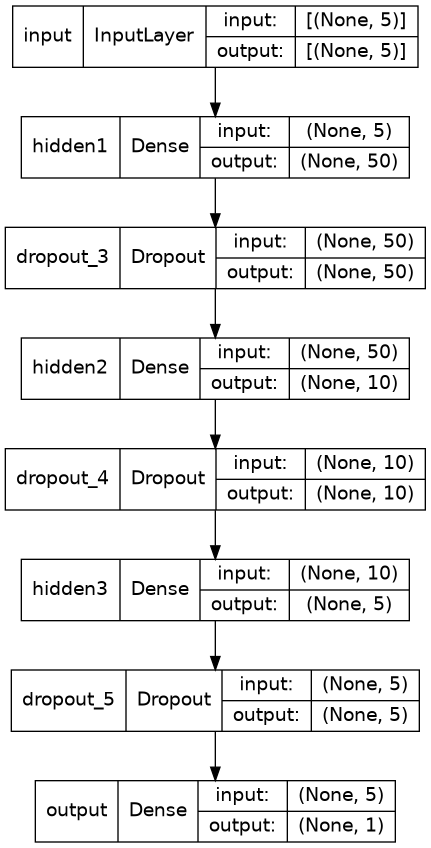

In [15]:
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [16]:
# The student can have his/her model saved:
model_file = 'hzzfourlepton_ANN.h5'

##Call functions implementation to monitor the chosen metrics
checkpoint = keras.callbacks.ModelCheckpoint(filepath = model_file,
                                             monitor = 'val_loss',
                                             mode='min',
                                             save_best_only = True)

#Stop training when a monitored metric has stopped improving
early_stop = keras.callbacks.EarlyStopping(monitor = 'val_loss',
                                           mode='min',# quantity that has to be monitored(to be minimized in this case)
                              patience = 50, # Number of epochs with no improvement after which training will be stopped.
                              min_delta = 1e-7,
                              restore_best_weights = True) # update the model with the best-seen weights

#Reduce learning rate when a metric has stopped improving
reduce_LR = keras.callbacks.ReduceLROnPlateau( monitor = 'val_loss',
                                              mode='min',# quantity that has to be monitored
                                              min_delta=1e-7,
                                              factor = 0.1, # factor by which LR has to be reduced...
                                              patience = 10, #...after waiting this number of epochs with no improvements 
                                              #on monitored quantity
                                              min_lr= 0.00001 ) 


callback_list = [reduce_LR, early_stop, checkpoint]

In [17]:
# Number of training epochs
# nepochs=500
nepochs=200
# Batch size
batch=250
# Train classifier (2 minutes more or less)
history = model.fit(X_train_val[:,0:NINPUT], 
                    Y_train_val,
                    epochs=nepochs, 
                    sample_weight=W_train_val,
                    batch_size=batch,
                    callbacks = callback_list, 
                    verbose=1, # switch to 1 for more verbosity 
                    validation_split=0.3 ) # fix the validation dataset size

Epoch 1/200
308/308 [==============================] - 8s 25ms/step - loss: 8.5159e-06 - accuracy: 0.7580 - weighted_accuracy: 0.7900 - val_loss: 6.8386e-06 - val_accuracy: 0.8087 - val_weighted_accuracy: 0.8109 - lr: 1.0000e-04
Epoch 2/200
308/308 [==============================] - 1s 2ms/step - loss: 6.2320e-06 - accuracy: 0.8165 - weighted_accuracy: 0.8115 - val_loss: 5.6946e-06 - val_accuracy: 0.8192 - val_weighted_accuracy: 0.8143 - lr: 1.0000e-04
Epoch 3/200
308/308 [==============================] - 1s 2ms/step - loss: 5.7629e-06 - accuracy: 0.8134 - weighted_accuracy: 0.8172 - val_loss: 5.4263e-06 - val_accuracy: 0.8197 - val_weighted_accuracy: 0.8195 - lr: 1.0000e-04
Epoch 4/200
308/308 [==============================] - 1s 2ms/step - loss: 5.5112e-06 - accuracy: 0.8039 - weighted_accuracy: 0.8248 - val_loss: 5.1696e-06 - val_accuracy: 0.7967 - val_weighted_accuracy: 0.8316 - lr: 1.0000e-04
Epoch 5/200
308/308 [==============================] - 1s 2ms/step - loss: 5.2383e-06 -

In [18]:
model = keras.models.load_model('hzzfourlepton_ANN.h5')

<ipython-input-19-7669b10a28b3>:40: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-k" (-> color='k'). The keyword argument will take precedence.
  ax.plot([0.3, 0.5, 0.7], [0.6, 0.9, 0.6], '-k',color='red')
<ipython-input-19-7669b10a28b3>:41: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-k" (-> color='k'). The keyword argument will take precedence.
  ax.plot([0.12, 0.3, 0.38], [0.3, 0.6, 0.3], '-k',color='blue')


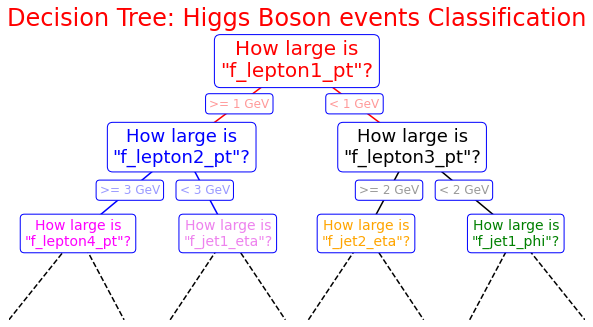

In [19]:
fig = plt.figure(figsize=(10, 4))
ax = fig.add_axes([0, 0, 0.8, 1], frameon=False, xticks=[], yticks=[])
ax.set_title('Decision Tree: Higgs Boson events Classification', size=24,color='red')

def text(ax, x, y, t, size=20, **kwargs):
    ax.text(x, y, t,
            ha='center', va='center', size=size,
            bbox=dict( boxstyle='round', ec='blue', fc='w' ), **kwargs)
    
# Here you are the variables we can use for the training phase:
# --------------------------------------------------------------------------
# High level features:
# ['f_massjj', 'f_deltajj', 'f_mass4l', 'f_Z1mass' , 'f_Z2mass']
# --------------------------------------------------------------------------
# Low level features:
#        [ 'f_lept1_pt','f_lept1_eta','f_lept1_phi', \
#          'f_lept2_pt','f_lept2_eta','f_lept2_phi', \
#          'f_lept3_pt','f_lept3_eta','f_lept3_phi', \
#          'f_lept4_pt','f_lept4_eta','f_lept4_phi', \
#          'f_jet1_pt','f_jet1_eta','f_jet1_phi', \
#          'f_jet2_pt','f_jet2_eta','f_jet2_phi']
#---------------------------------------------------------------------------
text(ax, 0.5, 0.9, "How large is\n\"f_lepton1_pt\"?", 20,color='red')
text(ax, 0.3, 0.6, "How large is\n\"f_lepton2_pt\"?", 18,color='blue')
text(ax, 0.7, 0.6, "How large is\n\"f_lepton3_pt\"?", 18)
text(ax, 0.12, 0.3, "How large is\n\"f_lepton4_pt\"?", 14,color='magenta')
text(ax, 0.38, 0.3, "How large is\n\"f_jet1_eta\"?", 14,color='violet')
text(ax, 0.62, 0.3, "How large is\n\"f_jet2_eta\"?", 14,color='orange')
text(ax, 0.88, 0.3, "How large is\n\"f_jet1_phi\"?", 14,color='green')

text(ax, 0.4, 0.75, ">= 1 GeV", 12, alpha=0.4,color='red')
text(ax, 0.6, 0.75, "< 1 GeV", 12, alpha=0.4,color='red')

text(ax, 0.21, 0.45, ">= 3 GeV", 12, alpha=0.4,color='blue')
text(ax, 0.34, 0.45, "< 3 GeV", 12, alpha=0.4,color='blue')

text(ax, 0.66, 0.45, ">= 2 GeV", 12, alpha=0.4,color='black')
text(ax, 0.79, 0.45, "< 2 GeV", 12, alpha=0.4,color='black')

ax.plot([0.3, 0.5, 0.7], [0.6, 0.9, 0.6], '-k',color='red')
ax.plot([0.12, 0.3, 0.38], [0.3, 0.6, 0.3], '-k',color='blue')
ax.plot([0.62, 0.7, 0.88], [0.3, 0.6, 0.3], '-k')
ax.plot([0.0, 0.12, 0.20], [0.0, 0.3, 0.0], '--k')
ax.plot([0.28, 0.38, 0.48], [0.0, 0.3, 0.0], '--k')
ax.plot([0.52, 0.62, 0.72], [0.0, 0.3, 0.0], '--k')
ax.plot([0.8, 0.88, 1.0], [0.0, 0.3, 0.0], '--k')
ax.axis([0, 1, 0, 1])

fig.savefig('05.08-decision-tree.png')

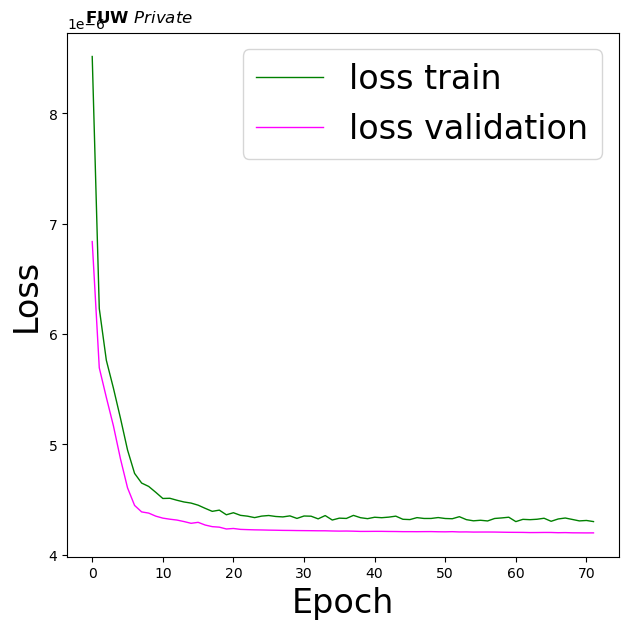

In [68]:
# plot the loss fuction vs epoch during the training phase
# the plot of the loss function on the validation set is also computed and plotted
plt.rcParams['figure.figsize'] = (6,6)
plt.plot(history.history['loss'], label='loss train',color='green', linewidth=1)
plt.plot(history.history['val_loss'], label='loss validation',color='magenta', linewidth=1)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.legend(loc="upper right")
plt.tight_layout()
plt.legend(fontsize=24)
plt.xlabel('Epoch', fontsize=24)
plt.ylabel('Loss', fontsize=24)
plt.savefig('ANN_loss.pdf', bbox_inches='tight')
plt.savefig('ANN_loss.png', dpi=300, bbox_inches='tight')
plt.show()

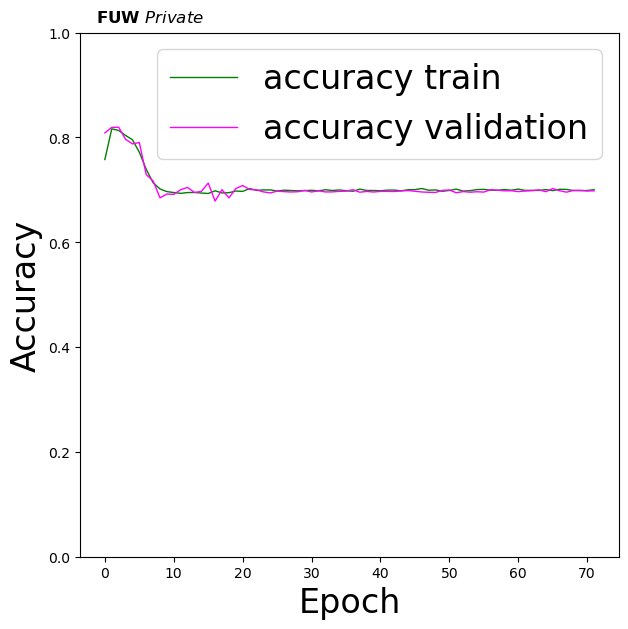

In [69]:
# Plot accuracy metrics vs epoch during the training
# for the proper training dataset and the validation one
plt.rcParams['figure.figsize'] = (6,6)
plt.plot(history.history['accuracy'], label='accuracy train',color='green', linewidth=1)
plt.plot(history.history['val_accuracy'], label='accuracy validation',color='magenta', linewidth=1)
plt.ylim([0, 1.0])
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.legend(loc="lower left")
plt.tight_layout()
plt.legend(fontsize=24)
plt.xlabel('Epoch', fontsize=24)
plt.ylabel('Accuracy', fontsize=24)
plt.savefig('ANN_accuracy.pdf', bbox_inches='tight')
plt.savefig('ANN_accuracy.png', dpi=300, bbox_inches='tight')
plt.show()

In [22]:
# Get ANN model label predictions and performance metrics curves, after having trained the model
y_true = Y_test[:,0]
y_true_train = Y_train_val[:,0]
w_test = W_test[:,0]
w_train = W_train_val[:,0]
Y_prediction = model.predict(X_test[:,0:NINPUT])

# Get precision, recall, 
p, r, t = precision_recall_curve( y_true= Y_test, probas_pred= Y_prediction , 
                                 sample_weight=w_test )
# Get False Positive Rate (FPR) True Positive Rate (TPR) , Thresholds/Cut on the ANN's score
fpr, tpr, thresholds = roc_curve( y_true= Y_test,  y_score= Y_prediction, sample_weight=w_test )


Y_prediction_train = model.predict(X_train_val[:,0:NINPUT])
p_train, r_train, t_train = precision_recall_curve( Y_train_val, Y_prediction_train ,
                                                   sample_weight=w_train )
fpr_train, tpr_train, thresholds_train = roc_curve(Y_train_val, Y_prediction_train,
                                                   sample_weight=w_train)

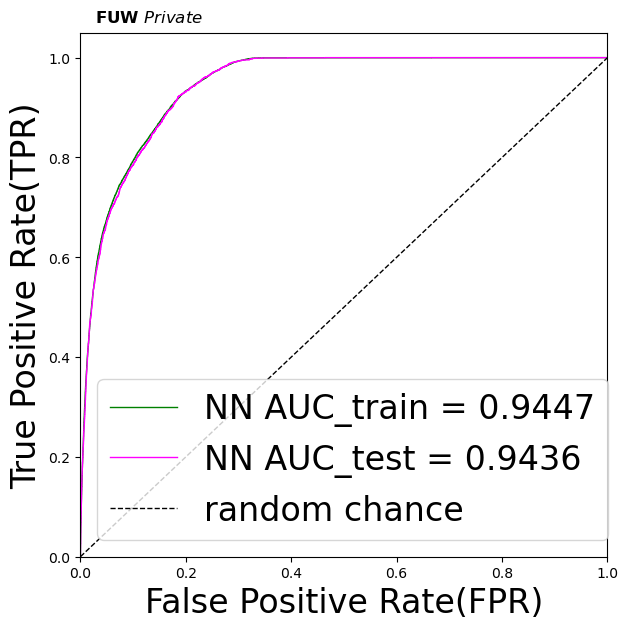

In [70]:
# Plotting the ANN ROC curve on the test and training datasets
roc_auc = auc(fpr, tpr)
roc_auc_train = auc(fpr_train,tpr_train)
plt.rcParams['figure.figsize'] = (6,6)
plt.plot(fpr_train, tpr_train,  color='green', linewidth=1, label='NN AUC_train = %.4f' % (roc_auc_train))
plt.plot(fpr, tpr, color='magenta', linewidth=1, label='NN AUC_test = %.4f' % (roc_auc))
# Comparison with the random chance curve
plt.plot([0, 1], [0, 1], linestyle='--', color='k', label='random chance', linewidth=1)
plt.xlim([0, 1.0]) #fpr
plt.ylim([0, 1.05]) #tpr
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.xlabel('False Positive Rate(FPR)', fontsize=24)
plt.ylabel('True Positive Rate(TPR)', fontsize=24)
#plt.title('Receiver Operating Characteristic (ROC)',fontsize=12,fontweight='bold', color='r')
plt.legend(loc="lower right")
plt.legend(fontsize=24)
plt.savefig('ANN_ROC.pdf', bbox_inches='tight')
plt.savefig('ANN_ROC.png', dpi=300, bbox_inches='tight')
plt.show()

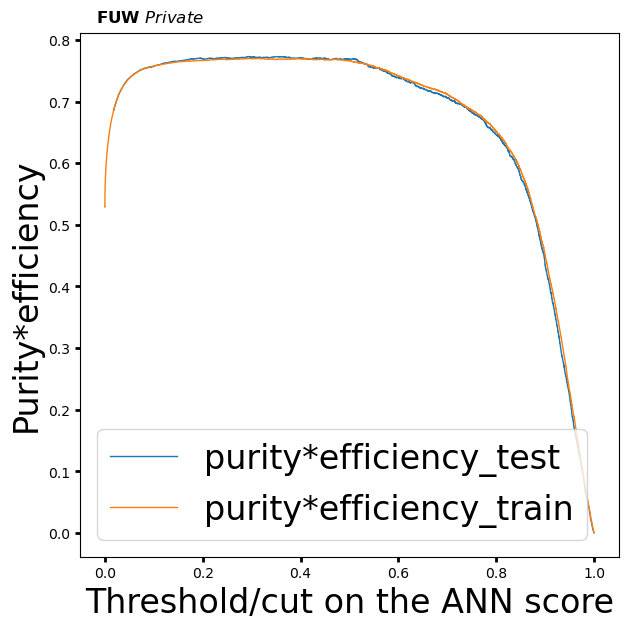

In [67]:
# Plot of the metrics Efficiency x Purity -- ANN 
# Looking at this curve we will choose a threshold on the ANN score
# for distinguishing between signal and background events
#plt.plot(t, p[:-1], label='purity_test')
#plt.plot(t_train, p_train[:-1], label='purity_train')
#plt.plot(t, r[:-1], label='efficiency_test')
#plt.plot(t_train, r_train[:-1], label='efficiency_test')
plt.rcParams['figure.figsize'] = (6,6)
plt.plot(t,p[:-1]*r[:-1],label='purity*efficiency_test', linewidth=1)
plt.plot(t_train,p_train[:-1]*r_train[:-1],label='purity*efficiency_train', linewidth=1)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.xlabel('Threshold/cut on the ANN score', fontsize=24)
plt.ylabel('Purity*efficiency', fontsize=24)
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.legend(loc="lower left")
plt.legend(fontsize=24)
plt.savefig('ANN_scoreefficiency.pdf', bbox_inches='tight')
plt.savefig('ANN_scoreefficiency.png', dpi=300, bbox_inches='tight')
plt.show()

In [25]:
# Print metrics imposing a threshold for the test sample. In this way the student
# can use later the model's score to discriminate signal and bkg events for a fixing
# score

cut_dnn=0.6

# Transform predictions into a array of entries 0,1 depending if prediction is beyond the
# chosen threshold
y_pred = Y_prediction[:,0] 
y_pred[y_pred >= cut_dnn]= 1 #classify them as signal
y_pred[y_pred < cut_dnn]= 0 #classify them as background
y_pred_train = Y_prediction_train[:,0]
y_pred_train[y_pred_train>=cut_dnn]=1
y_pred_train[y_pred_train<cut_dnn]=0

print("y_true.shape",y_true.shape)
print("y_pred.shape",y_pred.shape)
print("w_test.shape",w_test.shape)
print("Y_prediction",Y_prediction)
print("y_pred",y_pred)

y_true.shape (27420,)
y_pred.shape (27420,)
w_test.shape (27420,)
Y_prediction [[0.]
 [1.]
 [0.]
 ...
 [0.]
 [1.]
 [0.]]
y_pred [0. 1. 0. ... 0. 1. 0.]


In [26]:
# Other Metrics values for the ANN algorithm having fixed an ANN score threshold
accuracy  = accuracy_score(y_true, y_pred, sample_weight=w_test)
precision = precision_score(y_true, y_pred, sample_weight=w_test)
recall    = recall_score(y_true, y_pred, sample_weight=w_test)
f1 = 2*precision*recall/(precision+recall)
cm = confusion_matrix( y_true, y_pred, sample_weight=w_test)
print('Cut/Threshold on the ANN output : %.4f' % cut_dnn)
print('ANN Test Accuracy: %.4f' % accuracy)
print('ANN Test Precision/Purity: %.4f' % precision)
print('ANN Test Sensitivity/Recall/TPR/Signal Efficiency: %.4f' % recall)
print('ANN Test F1: %.4f' %f1)
print('')


Cut/Threshold on the ANN output : 0.6000
ANN Test Accuracy: 0.8581
ANN Test Precision/Purity: 0.8546
ANN Test Sensitivity/Recall/TPR/Signal Efficiency: 0.8648
ANN Test F1: 0.8597



Cut/Threshold on the ANN output : 0.6000 

Confusion matrix ANN



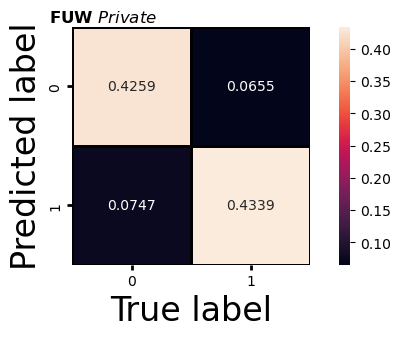

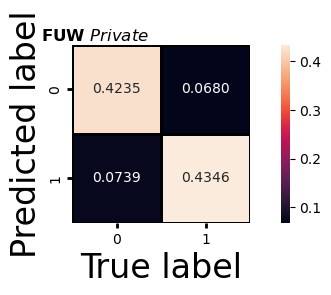

In [71]:
print('Cut/Threshold on the ANN output : %.4f \n' % cut_dnn )
print('Confusion matrix ANN\n')

plt.style.use('default') # It's ugly otherwise
plt.figure(figsize=(6,6) )


plt.subplot(2,1,1)
mat_train = confusion_matrix(y_true_train, y_pred_train,sample_weight=w_train,normalize='all')
sns.heatmap(mat_train.T, square=True, annot=True, fmt='.4f', cbar=True,linewidths=1,linecolor='black' )
plt.xlabel('True label', fontsize=24)
plt.ylabel('Predicted label', fontsize=24)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.tick_params(width=2, grid_alpha=0.5)
plt.savefig('ANN_cmtrain.pdf')
plt.savefig('ANN_cmtrain.png', dpi=300)
plt.show()

plt.subplot(2, 1, 2)
mat_test = confusion_matrix(y_true, y_pred ,sample_weight=w_test,normalize='all' )
sns.heatmap(mat_test.T, square=True, annot=True, fmt='.4f', cbar=True,linewidths=1,linecolor='black')
plt.xlabel('True label', fontsize=24)
plt.ylabel('Predicted label', fontsize=24)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.tick_params(width=2, grid_alpha=0.5)
plt.savefig('ANN_cmtest.pdf', bbox_inches='tight')
plt.savefig('ANN_cmtest.png', dpi=300, bbox_inches='tight')
plt.show()

In [30]:
# Let's get signal and background events for both test and training dataset!

df_sig  = df['sig'].filter(NN_VARS)
df_bkg  = df['bkg'].filter(NN_VARS)

X_sig  = np.asarray( df_sig.values ).astype(np.float32)
X_bkg  = np.asarray( df_bkg.values ).astype(np.float32)

df_test = df_all.iloc[0:test_size+1]
df_train = df_all.iloc[test_size+1:size]

df_test_sig = df_test[(df_test['isSignal']>=1)].filter(NN_VARS)
df_test_bkg = df_test[(df_test['isSignal']<1)].filter(NN_VARS)

df_train_sig = df_train[(df_train['isSignal']>=1)].filter(NN_VARS)
df_train_bkg = df_train[(df_train['isSignal']<1)].filter(NN_VARS)

X_test_sig  = np.asarray( df_test_sig.values ).astype(np.float32)
X_test_bkg  = np.asarray( df_test_bkg.values ).astype(np.float32)
X_train_sig  = np.asarray( df_train_sig.values ).astype(np.float32)
X_train_bkg  = np.asarray( df_train_bkg.values ).astype(np.float32)

print('Test dataset shape:')
print(df_test.shape)
print('Test dataset signal shape:')
print(df_test_sig.shape)
print('Test dataset background shape:')
print(df_test_bkg.shape)
print('Training dataset shape' )
print(df_train.shape)
print('Training signal dataset shape' )
print(df_train_sig.shape)
print('Training background dataset shape' )
print(df_train_bkg.shape)

Y_test_sig = model.predict(X_test_sig) #flag predicted on all signal events
Y_test_bkg = model.predict(X_test_bkg) #flag predicted on all background events
Y_train_sig = model.predict(X_train_sig)
Y_train_bkg = model.predict(X_train_bkg)

Test dataset shape:
(27420, 27)
Test dataset signal shape:
(2891, 5)
Test dataset background shape:
(24529, 5)
Training dataset shape
(109677, 27)
Training signal dataset shape
(11369, 5)
Training background dataset shape
(98308, 5)


In [31]:
df_test.head()

,f_run,f_event,f_weight,f_massjj,f_deltajj,f_mass4l,f_Z1mass,f_Z2mass,f_lept1_pt,f_lept1_eta,...,f_lept4_pt,f_lept4_eta,f_lept4_phi,f_jet1_pt,f_jet1_eta,f_jet1_phi,f_jet2_pt,f_jet2_eta,f_jet2_phi,isSignal
652790,1,49791449,0.000013,31.257435,0.739959,195.164886,92.583565,88.360504,49.588291,1.063168,...,18.262388,-1.336718,-2.107256,37.245415,1.237014,-0.999860,31.487768,1.976973,-1.048056,0.0
112875,1,1487200,0.000004,243.829742,3.701086,121.816742,89.452065,25.554550,60.426441,1.398740,...,8.303762,-1.437374,-1.123069,42.610504,0.549854,1.818177,35.186935,-3.151232,0.965770,0.0
467770,1,90624637,0.000012,198.027985,2.822334,91.237999,45.664551,36.536781,42.339371,-2.095333,...,8.378343,-1.486475,1.828703,59.551338,-1.081816,0.597498,37.140270,1.740518,-1.326264,0.0
342042,1,32182853,0.000014,169.012100,2.555497,139.406082,93.945908,13.961064,42.395634,1.962494,...,8.626534,0.152632,1.571934,34.968914,-3.632632,0.873708,55.875542,-1.077135,-1.370001,0.0
600282,1,30160698,0.000010,61.702358,0.670155,155.281143,98.027405,37.243118,56.337883,-2.041645,...,5.939044,0.236434,-2.658092,36.321613,-1.901348,-1.418714,30.989578,-2.571503,2.931275,0.0


In [32]:
df_all.head()

,f_run,f_event,f_weight,f_massjj,f_deltajj,f_mass4l,f_Z1mass,f_Z2mass,f_lept1_pt,f_lept1_eta,...,f_lept4_pt,f_lept4_eta,f_lept4_phi,f_jet1_pt,f_jet1_eta,f_jet1_phi,f_jet2_pt,f_jet2_eta,f_jet2_phi,isSignal
652790,1,49791449,0.000013,31.257435,0.739959,195.164886,92.583565,88.360504,49.588291,1.063168,...,18.262388,-1.336718,-2.107256,37.245415,1.237014,-0.999860,31.487768,1.976973,-1.048056,0.0
112875,1,1487200,0.000004,243.829742,3.701086,121.816742,89.452065,25.554550,60.426441,1.398740,...,8.303762,-1.437374,-1.123069,42.610504,0.549854,1.818177,35.186935,-3.151232,0.965770,0.0
467770,1,90624637,0.000012,198.027985,2.822334,91.237999,45.664551,36.536781,42.339371,-2.095333,...,8.378343,-1.486475,1.828703,59.551338,-1.081816,0.597498,37.140270,1.740518,-1.326264,0.0
342042,1,32182853,0.000014,169.012100,2.555497,139.406082,93.945908,13.961064,42.395634,1.962494,...,8.626534,0.152632,1.571934,34.968914,-3.632632,0.873708,55.875542,-1.077135,-1.370001,0.0
600282,1,30160698,0.000010,61.702358,0.670155,155.281143,98.027405,37.243118,56.337883,-2.041645,...,5.939044,0.236434,-2.658092,36.321613,-1.901348,-1.418714,30.989578,-2.571503,2.931275,0.0


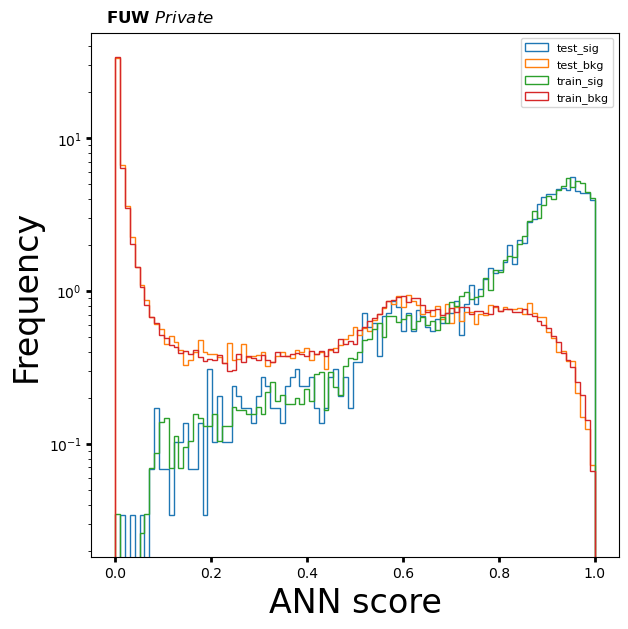

In [72]:
# Normalized Distribution of the ANN score for the whole dataset
# ax = plt.subplot(4, 2, 4)
X = np.linspace(0.0, 1.0, 100) #100 numbers between 0 and 1
plt.rcParams['figure.figsize'] = (6,6)
hist_test_sig = plt.hist(Y_test_sig, bins=X, label='test_sig',histtype='step',log=True,density=1)
hist_test_bkg = plt.hist(Y_test_bkg, bins=X, label='test_bkg',histtype='step',log=True,density=1)
hist_train_sig = plt.hist(Y_train_sig, bins=X, label='train_sig',histtype='step',log=True,density=1)
hist_train_bkg = plt.hist(Y_train_bkg, bins=X, label='train_bkg',histtype='step',log=True,density=1)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.xlabel('ANN score', fontsize=24)
plt.ylabel('Frequency', fontsize=24)
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend( loc='upper right',prop={'size': 8} )
plt.savefig('ANN_scorevsfrequency.pdf', bbox_inches='tight')
plt.savefig('ANN_scorevdfrequency.png', dpi=300, bbox_inches='tight')
plt.show()

In [35]:
classifier = RandomForestClassifier(random_state=7)
# The first step we need to perform is to 
# create a dictionary of all the parameters and their corresponding 
# set of values that you want to test for best performance. 
# The name of the dictionary items corresponds to the parameter name 
# and the value corresponds to the list of values for the parameter.
# The parameter values that we want to try out 
# are passed in the list. In the below code we want to find 
# which values of the RF hyperparameters provides the highest accuracy

grid_param = {
     'criterion': ['gini','entropy'],
    'n_estimators': [300, 500],
    'bootstrap': [True, False],
    'max_depth': [3,5],
    'min_samples_leaf':[300,500],
    'min_samples_split':[200,400],
    'max_features':[3,4,5]
 }


# Once the parameter dictionary is created, 
# the next step is to create an instance of the GridSearchCV class. 
# You need to pass values for the estimator parameter, 
# which basically is the algorithm that you want to execute. 
# The param_grid parameter takes the parameter dictionary that we 
# just created as parameter, the scoring parameter takes the performance metrics, 
# the cv parameter corresponds to number of folds, 
# which is 5 in our case, and finally the n_jobs parameter refers to the 
# number of CPU's that you want to use for execution. 
# A value of -1 for n_jobs parameter means that use all available computing power. 
# This can be handy if you have large number amount of data.

gd_sr = GridSearchCV(estimator=classifier,
                     param_grid=grid_param, #parameter dictionary
                     scoring='accuracy', #performance metrics
                     cv=3, #number of folds
                     n_jobs=-1) #use all available computing power

# Time required : 7h 50 minutes
gd_sr.fit(X_train_val, np.ravel(Y_train_val))


best_parameters = gd_sr.best_params_
print('Best parameters:')
print(best_parameters)
best_result = gd_sr.best_score_
print('Best metrics score (accuracy):')
print(best_result)





# Best parameters:

# {'bootstrap': False, 'criterion': 'gini', 'max_depth': 5, 'max_features': 4, 
# 'min_samples_leaf': 500, 'min_samples_split': 200, 'n_estimators': 300}
# Best metrics score (accuracy):
# 0.9199343250564441
rfc=RandomForestClassifier( n_estimators=300,criterion='gini',
                           verbose=0 , min_samples_split=200, 
                           max_depth= 5,min_samples_leaf=500, 
                           max_features=4, bootstrap=False,random_state=7 )

# Use the same sets X_train_val, X_test, Y_train_val, Y_test , W_train_val , 
# W_test used for the ANN in order to train our Random Forest algorithm

randomforest=rfc.fit(X_train_val,np.ravel(Y_train_val),np.ravel(W_train_val))

# Save to file in the current working directory
pkl_filename = "rf_model.pkl"
with open(pkl_filename, 'wb') as file:
    pickle.dump(rfc, file)

Best parameters:
{'bootstrap': True, 'criterion': 'entropy', 'max_depth': 5, 'max_features': 3, 'min_samples_leaf': 500, 'min_samples_split': 200, 'n_estimators': 300}
Best metrics score (accuracy):
0.9281526664660777


In [36]:
#test data 
y_pred_rfc=randomforest.predict(X_test[:,0:NINPUT])
y_pred_rfc_prob= randomforest.predict_proba(X_test[:,0:NINPUT])
y_pred_rfc_proba = y_pred_rfc_prob[:,-1]
p_rf,r_rf,t_rf= precision_recall_curve(Y_test, probas_pred=y_pred_rfc_proba , sample_weight=w_test)
fpr_rf, tpr_rf, thresholds_rf = roc_curve(Y_test, y_score=y_pred_rfc_proba, sample_weight=w_test  )

# Do the same for the training dataset:
y_pred_rfc_train=randomforest.predict(X_train_val[:,0:NINPUT])
y_pred_rfc_train_prob= randomforest.predict_proba(X_train_val[:,0:NINPUT])
y_pred_rfc_train_proba = y_pred_rfc_train_prob[:,-1] #last element associated to the signal probability
p_train_rf, r_train_rf, t_train_rf = precision_recall_curve(Y_train_val, y_pred_rfc_train_proba, sample_weight=w_train)
fpr_train_rf, tpr_train_rf, thresholds_train_rf = roc_curve(Y_train_val, y_pred_rfc_train_proba, sample_weight=w_train)

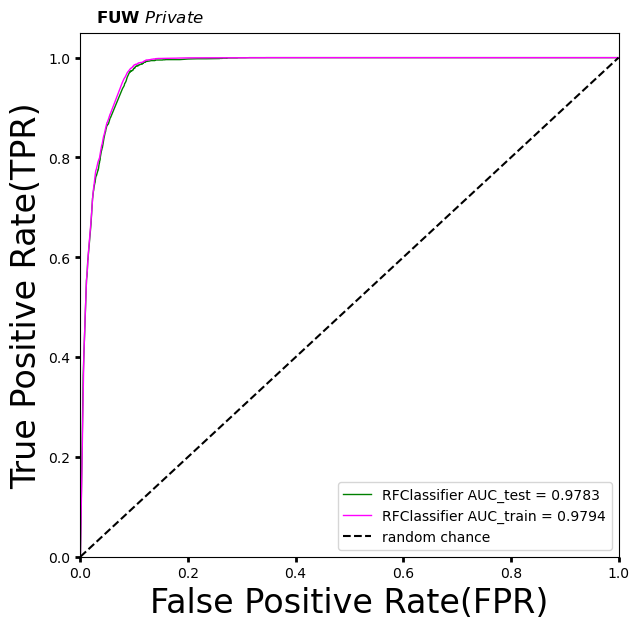

In [73]:
# Plotting the ROC curve for the Random Forest algorithm
roc_auc_rf = auc(fpr_rf,tpr_rf)
roc_auc_rf_train = auc(fpr_train_rf,tpr_train_rf)

plt.rcParams['figure.figsize'] = (6,6)
#Random Forest 1st method
plt.plot(fpr_rf,tpr_rf,  color='green', linewidth=1, label='RFClassifier AUC_test = %.4f' % (roc_auc_rf))
plt.plot(fpr_train_rf,tpr_train_rf, color='magenta', linewidth=1, label='RFClassifier AUC_train = %.4f' % (roc_auc_rf_train))
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
#Random Forest 2nd method : use the sklearn function "plot_roc_curve"
#rfc_disp = plot_roc_curve(rfc, X_train_val,Y_train_val,color='brown',ax=ax, sample_weight=w_train )
#rfc_disp = plot_roc_curve(rfc, X_test, Y_test, color='grey',ax=ax, sample_weight=w_test)
#random chance
plt.plot([0, 1], [0, 1], linestyle='--', color='k', label='random chance')
plt.xlim([0, 1.0]) #fpr
plt.ylim([0, 1.05]) #tpr
plt.xlabel('False Positive Rate(FPR)', fontsize=24)
plt.ylabel('True Positive Rate(TPR)', fontsize=24)
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.legend(loc="lower right")
plt.savefig('RF_ROC.pdf', bbox_inches='tight')
plt.savefig('RF_ROC.png', dpi=300, bbox_inches='tight')
plt.show()

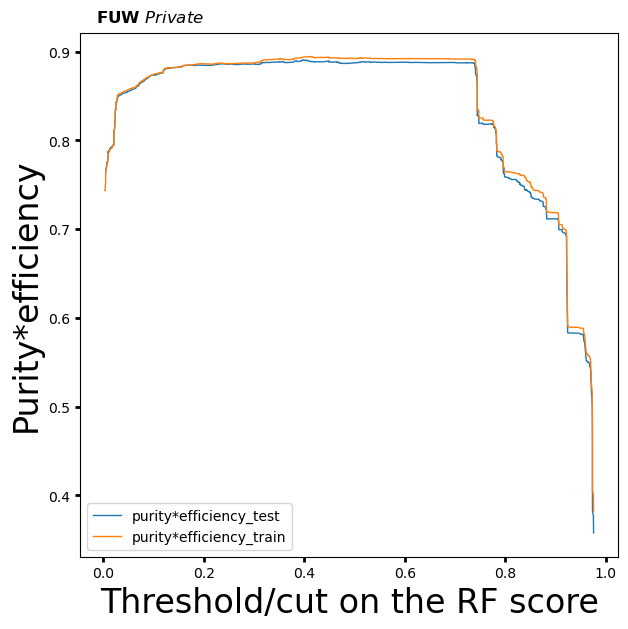

In [74]:
# Plot Efficiency x Purity -- Random Forest 

# Other metrics:
# plt.plot(t_rf, p_rf[:-1], label='purity_test')
# plt.plot(t_train_rf, p_train_rf[:-1], label='purity_test')
# plt.plot(t_rf, r_rf[:-1], label='efficiency_test')
# plt.plot(t_train_rf, r_train_rf[:-1], label='efficiency_train')
plt.rcParams['figure.figsize'] = (6,6)
plt.plot(t_rf,p_rf[:-1]*r_rf[:-1],label='purity*efficiency_test', linewidth=1)
plt.plot(t_train_rf,p_train_rf[:-1]*r_train_rf[:-1],label='purity*efficiency_train', linewidth=1)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.ylabel('Purity*efficiency', fontsize=24)
plt.xlabel('Threshold/cut on the RF score', fontsize=24)
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_efficiencypurity.pdf', bbox_inches='tight')
plt.savefig('RF_efficiencypurity.png', dpi=300, bbox_inches='tight')
plt.show()

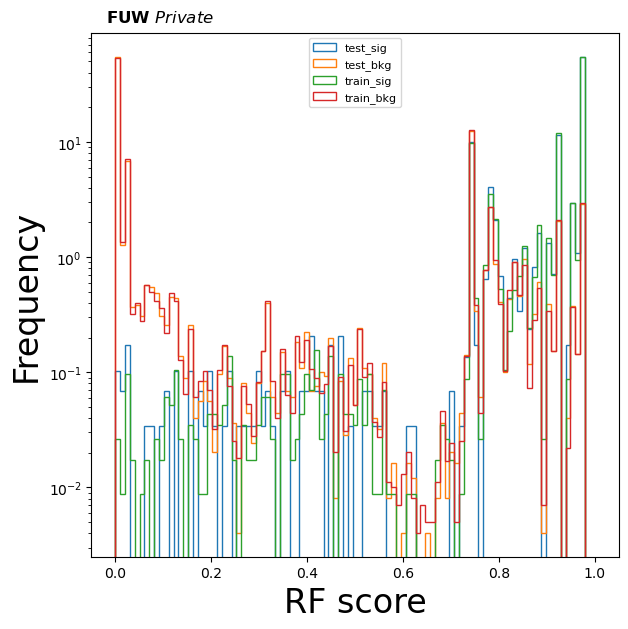

In [75]:
# Random Forest score for training and test datasets (bkg and sig)

Y_sig_rfc = randomforest.predict_proba(X_sig) #probability of belonging to the signal(bkg) class for all signal events
Y_bkg_rfc = randomforest.predict_proba(X_bkg)  #probability of belonging to the signal(bkg) class for all bkg events
Y_test_sig_rf= randomforest.predict_proba(X_test_sig) # the same for all signal events in the test dataset
Y_test_bkg_rf = randomforest.predict_proba(X_test_bkg) # the same for all bkg events in the test dataset
Y_train_sig_rf = randomforest.predict_proba(X_train_sig) # the same for all sig events in the training dataset
Y_train_bkg_rf = randomforest.predict_proba(X_train_bkg) # the same for all bkg events in the training dataset

# Random Forest score Plot for the whole dataset: RF score normalized distribution on the whole dataset
X = np.linspace(0.0, 1.0, 100) #100 numbers between 0 and 1
plt.rcParams['figure.figsize'] = (6,6)
hist_test_sig = plt.hist(Y_test_sig_rf[:,1], bins=X, label='test_sig',histtype='step',log=True,density=1 )
hist_test_bkg = plt.hist(Y_test_bkg_rf[:,1], bins=X, label='test_bkg',histtype='step',log=True,density=1)
hist_train_sig = plt.hist(Y_train_sig_rf[:,1], bins=X, label='train_sig',histtype='step',log=True,density=1)
hist_train_bkg = plt.hist(Y_train_bkg_rf[:,1], bins=X, label='train_bkg',histtype='step',log=True,density=1)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.xlabel('RF score', fontsize=24)
plt.ylabel('Frequency', fontsize=24)
plt.legend( loc='upper center',prop={'size': 8} )
#plt.title('RF score normalized distribution on the whole dataset',fontsize=12,fontweight='bold', color='r')
plt.savefig('RF_scorevsfrequency.pdf', bbox_inches='tight')
plt.savefig('RF_scorevsfrequency.png', dpi=300, bbox_inches='tight')
plt.show()

In [43]:
# We choose a threshold on the RF score for labelling signal and background events looking at the 
# previous plots
cut_rf=0.6

y_pred_rfc[y_pred_rfc >= cut_rf]=1 #classify them as signal
y_pred_rfc[y_pred_rfc < cut_rf]=0 #classify them as background

#print("y_pred_rfc.shape",y_pred_rfc.shape)
#print("y_pred_rfc",y_pred_rfc)

#Metrics for the RandomForest
accuracy_rfc  = accuracy_score(y_true, y_pred_rfc, sample_weight=w_test) #fraction of correctly classified events
precision_rfc = precision_score(y_true, y_pred_rfc, sample_weight=w_test) #Precision of the positive class in binary classification
recall_rfc    = recall_score(y_true, y_pred_rfc, sample_weight=w_test) #Recall of the positive class in binary classification 
f1_rfc = 2*precision_rfc*recall_rfc/(precision_rfc+recall_rfc)
print('Cut/Threshold on the Random Forest output : %.4f' % cut_rf)
print('Random Forest Test Accuracy: %.4f' % accuracy_rfc)
print('Random Forest Test Precision/Purity:  %.4f' % precision_rfc)
print('Random Forest Test Sensitivity/Recall/TPR/Signal Efficiency: %.4f' % recall_rfc)
print('RF Test F1:   %.4f' %f1_rfc)
print('')

Cut/Threshold on the Random Forest output : 0.6000
Random Forest Test Accuracy: 0.9392
Random Forest Test Precision/Purity:  0.9111
Random Forest Test Sensitivity/Recall/TPR/Signal Efficiency: 0.9741
RF Test F1:   0.9416



Cut/Threshold on the Random Forest output : 0.6000


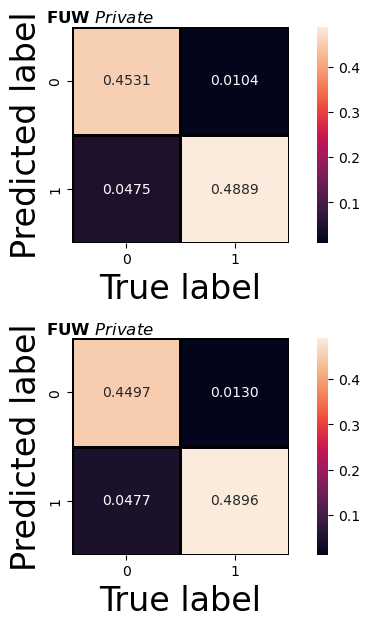

In [76]:
print('Cut/Threshold on the Random Forest output : %.4f' % cut_rf)
#cm_rfc = confusion_matrix( y_true, y_pred_rfc, sample_weight=w_test)
#disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_rfc, display_labels='bs' )
#disp_rfc.plot()

plt.style.use('default') # It's ugly otherwise
plt.figure(figsize=(6,6) )


plt.subplot(2,1,1)
mat = confusion_matrix(y_true_train, y_pred_rfc_train,sample_weight=w_train,normalize='all' )
sns.heatmap(mat.T, square=True, annot=True, fmt='.4f', cbar=True,linewidths=1,linecolor='black')
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.xlabel('True label', fontsize=24)
plt.ylabel('Predicted label', fontsize=24)
plt.savefig('RF_cmtrain.pdf')
plt.savefig('RF_cmtrain.png', dpi=300)

plt.subplot(2, 1, 2)
mat = confusion_matrix(y_true, y_pred_rfc ,sample_weight=w_test, normalize='all' )
sns.heatmap(mat.T, square=True, annot=True, fmt='.4f' ,  cbar=True,linewidths=1,linecolor='black')
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.xlabel('True label', fontsize=24)
plt.ylabel('Predicted label', fontsize=24)
plt.savefig('RF_cmtest.pdf', bbox_inches='tight')
plt.savefig('RF_cmtest.png', dpi=300, bbox_inches='tight')

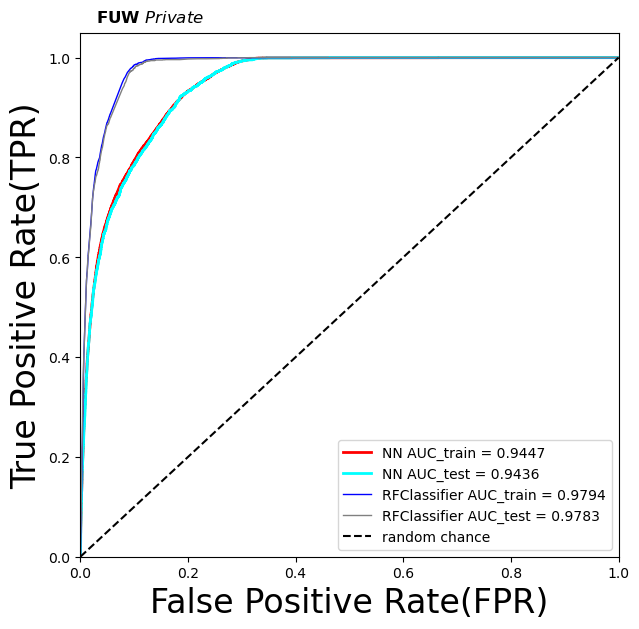

In [77]:
##Superimposition RF and ANN ROC curves
plt.rcParams['figure.figsize'] = (6,6)
plt.plot(fpr_train, tpr_train, color='red', linewidth=2, label='NN AUC_train = %.4f' % (roc_auc_train))
plt.plot(fpr, tpr,  color='cyan', linewidth=2, label='NN AUC_test = %.4f' % (roc_auc))
#Random Forest 1st method
plt.plot(fpr_train_rf,tpr_train_rf, color='blue', linewidth=1, label='RFClassifier AUC_train = %.4f' % (roc_auc_rf_train))
plt.plot(fpr_rf,tpr_rf, color='grey', linewidth=1, label='RFClassifier AUC_test = %.4f' % (roc_auc_rf))
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
#Random Forest 2nd method
#rfc_disp = plot_roc_curve(rfc, X_train_val,Y_train_val,color='brown',ax=ax, sample_weight=w_train )
#rfc_disp = plot_roc_curve(rfc, X_test, Y_test, color='grey',ax=ax, sample_weight=w_test)
#random chance
plt.plot([0, 1], [0, 1], linestyle='--', color='k', label='random chance')
plt.xlim([0, 1.0]) #fpr
plt.ylim([0, 1.05]) #tpr
plt.xlabel('False Positive Rate(FPR)', fontsize=24)
plt.ylabel('True Positive Rate(TPR)', fontsize=24)
plt.legend(loc="lower right")
plt.savefig('RF_ANN_ROCComp.pdf', bbox_inches='tight')
plt.savefig('RF_ANN_ROCComp.png', dpi=300, bbox_inches='tight')
plt.show()

In [46]:
data = df_all.filter(NN_VARS)
X_all   = np.asarray( data.values ).astype(np.float32)
#Use it for evaluating the NN output score for the entire dataset
Y_all = model.predict(X_all)

In [47]:
# Add the ANN prediction array 'NNoutput'column to the complete dataframe in order 
# keep the information about the ML algorithm prediction for every event in the whole dataset
df_all['NNoutput'] = Y_all
# Selects events with NNoutput > cut (and RFoutput > cut_rf later on)
cut_dnn = 0.6
df_sel   = df_all[(df_all['NNoutput'] >= cut_dnn)]
df_TP    = df_all[(df_all['NNoutput'] >= cut_dnn) & (df_all['isSignal'] == 1)]
df_unsel = df_all[(df_all['NNoutput'] < cut_dnn)]
df_TN    = df_all[(df_all['NNoutput'] < cut_dnn) & (df_all['isSignal'] == 0)]

TP = len(df_TP)
FP = len(df_sel) - TP
TN = len(df_TN)
FN = len(df_unsel) - TN

truepositiverate = float(TP)/(TP+FN)
fakepositiverate = float(FP)/(FP+FN)
print('ANN score cut chosen:%.4f' % cut_dnn)
print("TP rate = %.4f"%truepositiverate)
print("FP rate = %.4f"%fakepositiverate)

ANN score cut chosen:0.6000
TP rate = 0.8663
FP rate = 0.9429


In [49]:
#for random forest 
Y_all_rf = randomforest.predict(X_all)
df_all['RFoutput'] = Y_all_rf

cut_rf = 0.6 
df_sel_rf   = df_all[(df_all['RFoutput'] >= cut_rf)]
df_TP_rf    = df_all[(df_all['RFoutput'] >= cut_rf) & (df_all['isSignal'] == 1)]
df_unsel_rf = df_all[(df_all['RFoutput'] < cut_rf)]
df_TN_rf    = df_all[(df_all['RFoutput'] < cut_rf) & (df_all['isSignal'] == 0)]

TP_rf = len(df_TP_rf)
FP_rf = len(df_sel_rf) - TP_rf
TN_rf = len(df_TN_rf)
FN_rf = len(df_unsel_rf) - TN_rf


truepositiverate_rf = float(TP_rf)/(TP_rf+FN_rf)
fakepositiverate_rf = float(FP_rf)/(FP_rf+FN_rf)
print('RF score cut chosen: %.4f' % cut_rf)
print("TP rate = %.4f"%truepositiverate_rf)
print("FP rate = %.4f"%fakepositiverate_rf)

RF score cut chosen: 0.6000
TP rate = 0.9776
FP rate = 0.9911


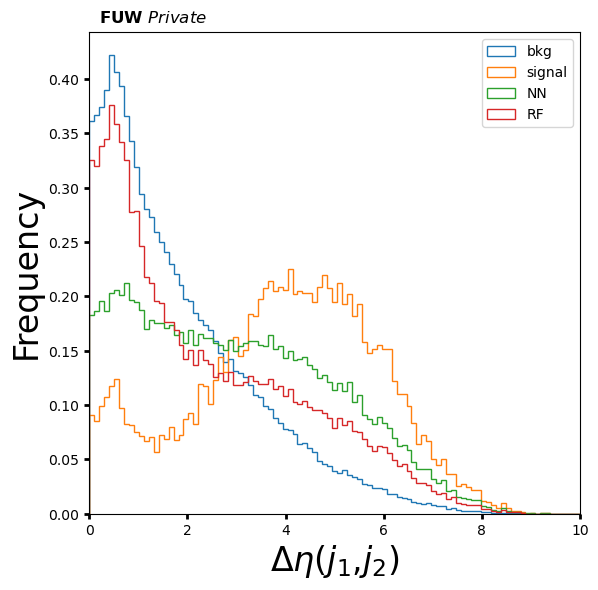

In [51]:
# Plot high level variables for signal, background and NN/RF selected events 

plt.xlabel('$\Delta \eta $($j_1$,$j_2$)', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(0.0,10.,100)
plt.rcParams['figure.figsize'] = (6,6)
# Plot bkg events
df_all['f_deltajj'][(df_all['isSignal'] == 0)].plot.hist( bins=X, label='bkg',histtype='step', density=1 )
# Plot signal events
df_all['f_deltajj'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step', density=1)
# selected ANN
df_sel['f_deltajj'].plot.hist(bins=X, label='NN',histtype='step', density=1)
# selected  RF 
df_sel_rf['f_deltajj'].plot.hist(bins=X, label='RF',histtype='step', density=1)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.xlim(0,10)
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_deltajets.pdf')
plt.savefig('RF_ANN_deltajets.png', dpi=300)
plt.show()

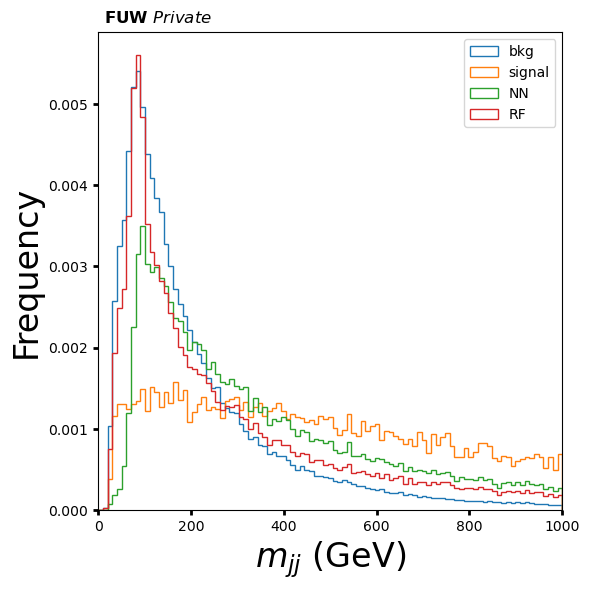

In [53]:

# Plot  dijets mass for signal, background and NN/RF selected events 
plt.xlabel('$m_{jj}$ (GeV)', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(0.0,1000.,100)
plt.rcParams['figure.figsize'] = (6,6)
df_all['f_massjj'][(df_all['isSignal'] == 0)].plot.hist(bins=X, label='bkg',histtype='step', density=1 )
df_all['f_massjj'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step', density=1)
df_sel['f_massjj'].plot.hist(bins=X, label='NN',histtype='step', density=1)
df_sel_rf['f_massjj'].plot.hist(bins=X, label='RF',histtype='step', density=1)
plt.xlim(0,1000)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_mjj.pdf')
plt.savefig('RF_ANN_mjj.png', dpi=300)
plt.show()

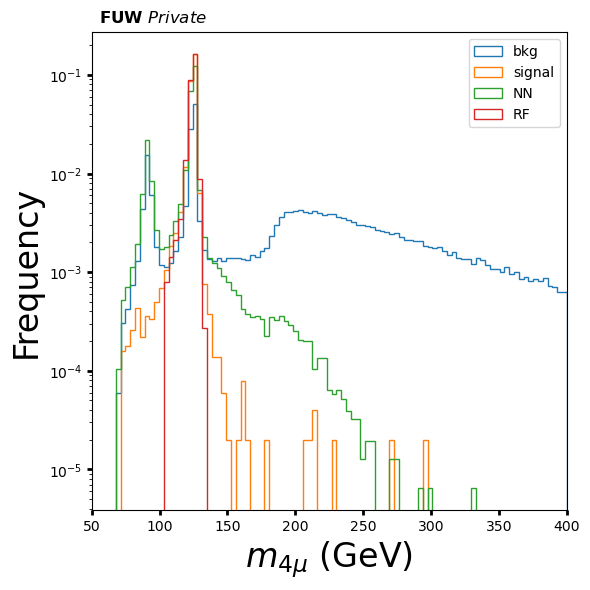

In [54]:
# Plot  dijets mass for signal, background and NN/RF selected events 
plt.xlabel('$m_{4\mu}$ (GeV)', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(50, 400, 100)
plt.rcParams['figure.figsize'] = (6,6)
df_all['f_mass4l'][(df_all['isSignal'] == 0)].plot.hist(bins=X, label='bkg',histtype='step',log=True, density=1)
df_all['f_mass4l'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step',log=True, density=1)
df_sel['f_mass4l'].plot.hist(bins=X, label='NN',histtype='step', log=True, density=1)
df_sel_rf['f_mass4l'].plot.hist(bins=X, label='RF',histtype='step',log=True, density=1)
plt.xlim(50,400)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_m4mu.pdf')
plt.savefig('RF_ANN_m4mu.png', dpi=300)
plt.show()

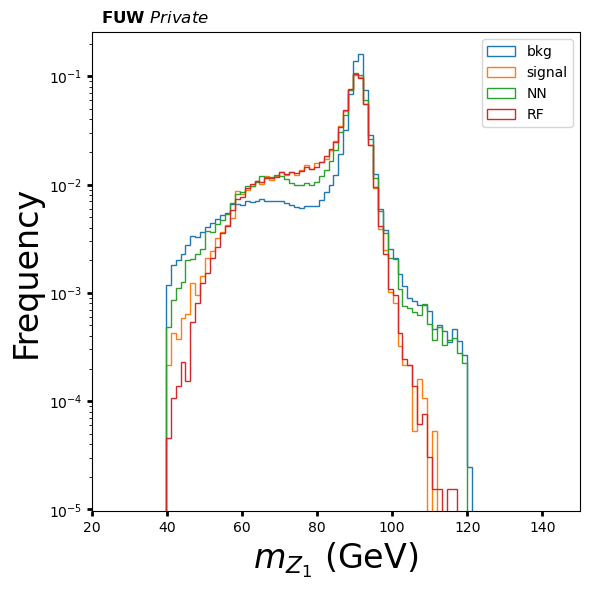

In [56]:
plt.xlabel('$m_{Z_{1}}$ (GeV)', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(20, 150, 100)
plt.rcParams['figure.figsize'] = (10,5)
df_all['f_Z1mass'][(df_all['isSignal'] == 0)].plot.hist(bins=X, label='bkg',histtype='step',log=True ,density=1)
df_all['f_Z1mass'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step',log=True, density=1)
df_sel['f_Z1mass'].plot.hist(bins=X, label='NN',histtype='step', log=True,density=1)
df_sel_rf['f_Z1mass'].plot.hist(bins=X, label='RF',histtype='step',log=True, density=1)
plt.xlim(20,150)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_mZone.pdf')
plt.savefig('RF_ANN_mZone.png', dpi=300)
plt.show()

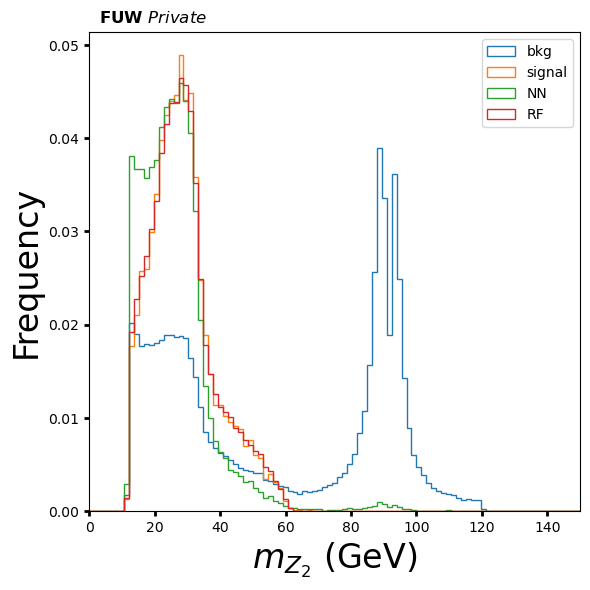

In [59]:
plt.xlabel('$m_{Z_{2}}$ (GeV)', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(0., 150, 100)
plt.rcParams['figure.figsize'] = (6,6)
df_all['f_Z2mass'][(df_all['isSignal'] == 0)].plot.hist(bins=X, label='bkg',histtype='step', density=1)
df_all['f_Z2mass'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step', density=1)
df_sel['f_Z2mass'].plot.hist(bins=X, label='NN',histtype='step', density=1)
df_sel_rf['f_Z2mass'].plot.hist(bins=X, label='RF',histtype='step', density=1)
plt.xlim(0.,150)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_mZtwo.pdf')
plt.savefig('RF_ANN_mZtwo.png', dpi=300)
plt.show()

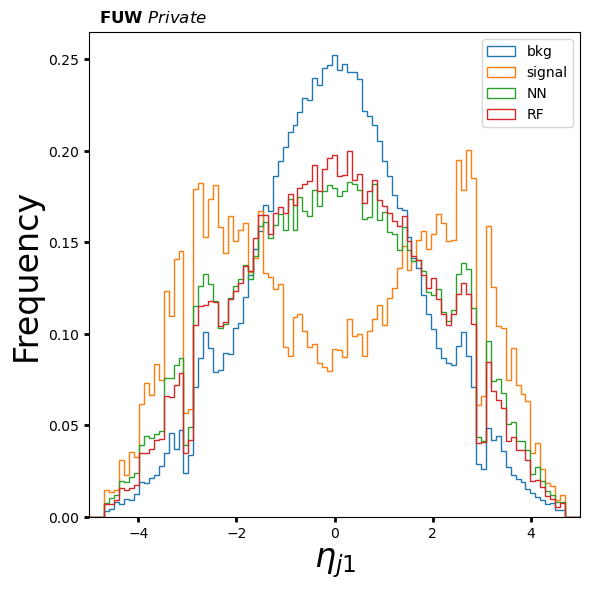

In [64]:
# Plot Jet1 eta for signal, background and NN/RF selected events 
plt.xlabel('$\eta_{j1}$', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(-5.,5.,100)
plt.rcParams['figure.figsize'] = (6,6)
df_all['f_jet1_eta'][(df_all['isSignal'] == 0)].plot.hist(bins=X, label='bkg',histtype='step', density=1)
df_all['f_jet1_eta'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step', density=1)
df_sel['f_jet1_eta'].plot.hist(bins=X, label='NN',histtype='step', density=1)
df_sel_rf['f_jet1_eta'].plot.hist(bins=X, label='RF',histtype='step', density=1)
plt.xlim(-5,5)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_etaj1.pdf')
plt.savefig('RF_ANN_etaj1.png', dpi=300)
plt.show()

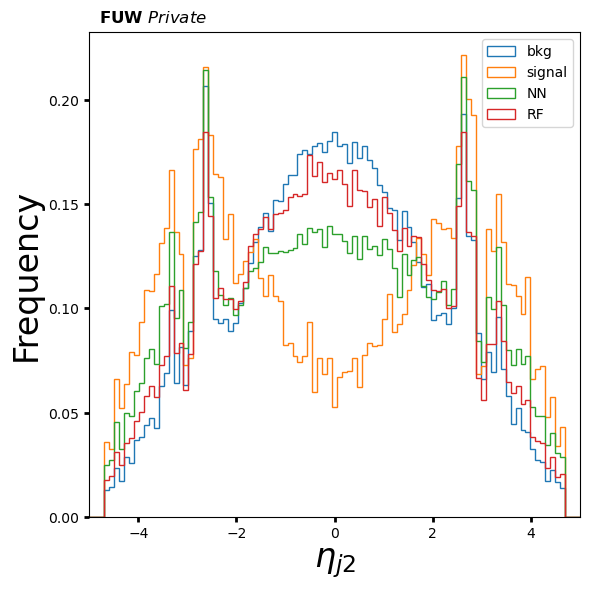

In [65]:
plt.xlabel('$\eta_{j2}$', fontsize=24)
plt.ylabel('Events(Normalized)', fontsize=24)
X = np.linspace(-5.,5.,100)
plt.rcParams['figure.figsize'] = (6,6)
df_all['f_jet2_eta'][(df_all['isSignal'] == 0)].plot.hist(bins=X, label='bkg',histtype='step', density=1)
df_all['f_jet2_eta'][(df_all['isSignal'] == 1)].plot.hist(bins=X, label='signal',histtype='step', density=1)
df_sel['f_jet2_eta'].plot.hist(bins=X, label='NN',histtype='step', density=1)
df_sel_rf['f_jet2_eta'].plot.hist(bins=X, label='RF',histtype='step', density=1)
plt.xlim(-5,5)
plt.text(0.13, 1.02, r'$\mathbf{FUW}$ $\mathit{Private}$', transform=plt.gca().transAxes, fontsize=12, ha='center', bbox=dict(facecolor='none', edgecolor='none', boxstyle='square'))
plt.tight_layout()
plt.legend(loc='best')
plt.tick_params(width=2, grid_alpha=0.5)
plt.legend(markerscale=50)
plt.savefig('RF_ANN_etaj2.pdf')
plt.savefig('RF_ANN_etaj2.png', dpi=300)
plt.show()

In [79]:
print(model.layers[0].get_weights())

[]
